In [8]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
import anndata as ad
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from tqdm.notebook import tqdm

In [9]:
parameter_dict = {
    "test_id": "combined-raw-kmeans", 
    "do_regress_out": True,
    "do_combat": False,
    "n_neighbors": [50],
    "n_pcs": [15],
    "cluster_resolution": [.5, 1, 1.5, 2],
}

In [19]:
base_path = 'Z:/Data/Analyzed/2024-01-08-Jiakun-MouseSpleen64Gene/'
output_path = os.path.join(base_path, 'output')
expr_path = os.path.join(base_path, 'expr')
test_path = os.path.join(output_path, parameter_dict['test_id'])
if not os.path.exists(test_path):
    os.mkdir(test_path)
    
cdata = sc.read_h5ad(os.path.join(expr_path, f'combined-raw.h5ad'))
cdata

AnnData object with n_obs × n_vars = 3158051 × 64
    obs: 'sample', 'fov_id', 'volume', 'fov_x', 'fov_y', 'fov_z', 'seg_label', 'global_x', 'global_y', 'global_z'

In [20]:
gene_annotation = pd.read_csv(os.path.join(base_path, 'documents', 'gene_annotation.csv'))
# gene_annotation.index = gene_annotation['Gene']
selected_genes = gene_annotation['Gene'].to_list()
gene_annotation

,Gene,Level1
0,Cd3d,T cells
1,Cd3e,T cells
2,Cd3g,T cells
3,Cd4,T cells
4,Adgre1,Macrophages
5,Cd68,Macrophages
6,Csf1r,Monocytes
7,Lyz2,Monocytes
8,Itgax,Dendritic cells
9,Xcr1,Dendritic cells


In [21]:
# pp 
sc.pp.normalize_total(cdata)
sc.pp.log1p(cdata)
cdata.raw = cdata
sc.pp.scale(cdata)
cdata.layers['scaled'] = cdata.X.copy()

C:\Users\jiahao\.conda\envs\sc_38\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


## Test


In [22]:
sdata = cdata[:, selected_genes]
sdata

View of AnnData object with n_obs × n_vars = 3158051 × 14
    obs: 'sample', 'fov_id', 'volume', 'fov_x', 'fov_y', 'fov_z', 'seg_label', 'global_x', 'global_y', 'global_z'
    var: 'mean', 'std'
    uns: 'log1p'
    layers: 'scaled'

C:\Users\jiahao\AppData\Local\Temp\ipykernel_32804\2781827192.py:12: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  sdata.obs[f'kmeans{k}'] = kmeans.labels_.astype(str)
C:\Users\jiahao\.conda\envs\sc_38\lib\contextlib.py:120: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  next(self.gen)


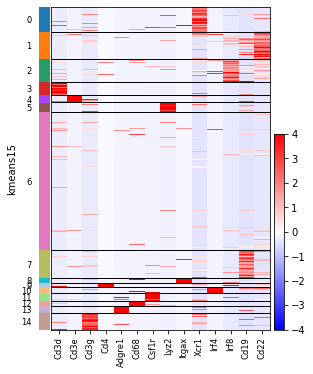

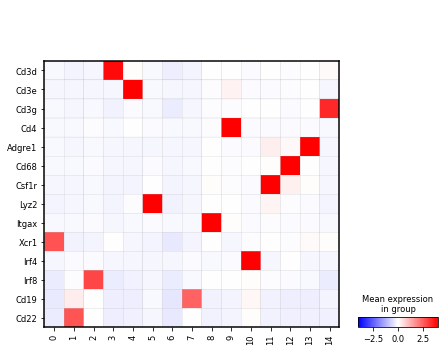

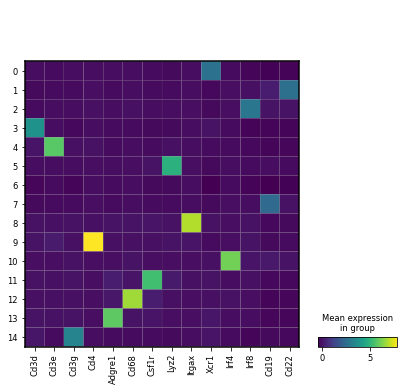

In [23]:
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score

# Use PCA embedding
# extract pca coordinates
# X_pca = sdata.obsm['X_pca']
X_pca = sdata.X

# kmeans with k=8
k = 15
kmeans = KMeans(n_clusters=k, random_state=5).fit(X_pca)
sdata.obs[f'kmeans{k}'] = kmeans.labels_.astype(str)

# sc.pl.pca(sdata, color=[f'kmeans{k}'])
sc.pl.heatmap(sdata, sdata.var.index, groupby=f'kmeans{k}', dendrogram=False, use_raw=False, cmap='bwr', vmin=-4, vmax=4)
sc.pl.matrixplot(sdata, sdata.var.index, groupby=f'kmeans{k}', dendrogram=False, use_raw=False, cmap='bwr', vmin=-4, vmax=4, swap_axes=True)
sc.pl.matrixplot(sdata, sdata.var.index, groupby=f'kmeans{k}', dendrogram=False, use_raw=False)

### assign cell types

In [28]:
# create backup for leiden label
sdata.obs['level_1'] = sdata.obs[f'kmeans{k}'].values

In [29]:
# Change cluster label to cell type label
transfer_dict_l1 = {}

# Level_1
level_1_list = [
    'Dendritic cells', #0
    'B cells', #1
    'Dendritic cells', #2
    'T cells', #3
    'T cells', #4
    'Monocytes', #5 
    'NA', #6
    'B cells', #7
    'Dendritic cells', #8
    'T cells', #9
    'Dendritic cells', #10 
    'Monocytes', #11
    'Macrophages', #12
    'Macrophages', #13
    'T cells', #14
]

# construct transfer dict
for i in sorted(sdata.obs[f'kmeans{k}'].unique()):
    transfer_dict_l1[i] = level_1_list[int(i)]

In [30]:
# Assign cell type to sdata
sdata.obs = sdata.obs.replace({'level_1': transfer_dict_l1})

In [31]:
level_1_order = ['T cells', 'B cells', 'Macrophages', 'Dendritic cells', 'Monocytes', 'NA']
sdata.obs['level_1'] = sdata.obs['level_1'].astype('category')
sdata.obs['level_1'] = sdata.obs['level_1'].cat.reorder_categories(level_1_order)

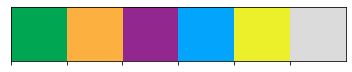

In [32]:
level_1_pl = sns.color_palette(['#00A651', '#FBB040', '#92278F', '#03a5fc', '#ecf02b', '#dbdbdb'])
level_1_cmap = ListedColormap(level_1_pl.as_hex())
sns.palplot(level_1_pl)

In [34]:
# add condition 
sdata.obs['condition'] = sdata.obs['sample'].values
condition_dict = {
    'sample1': 'WT',
    'sample2': "WT",
    'sample3': "99R",
    'sample4': '99R',
    'sample5': '33NM',
    'sample6': '33NM'
}
sdata.obs['condition'] = sdata.obs['condition'].map(condition_dict)
sdata.obs['condition'] = sdata.obs['condition'].astype('category')

In [57]:
total_counts = pd.DataFrame(sdata.obs['condition'].value_counts())
total_counts_dict = dict(zip(total_counts.index, total_counts.condition))

C:\Users\jiahao\AppData\Local\Temp\ipykernel_32804\2459178590.py:8: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  leiden_df['counts'] = leiden_df['counts'].astype(np.float)
C:\Users\jiahao\AppData\Local\Temp\ipykernel_32804\2459178590.py:9: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  leiden_df['total_counts'] = leiden_df['total_counts']

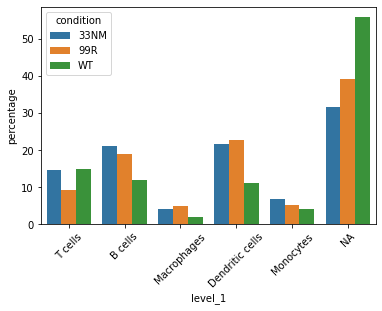

In [58]:
leiden_df = pd.DataFrame(sdata.obs.groupby('level_1')['condition'].value_counts().values)
leiden_df.columns = ['counts']
leiden_df['level_1'] = [i[0] for i in sdata.obs.groupby('level_1')['condition'].value_counts().index]
leiden_df['condition'] = [i[1] for i in sdata.obs.groupby('level_1')['condition'].value_counts().index]
leiden_df['condition'] = leiden_df['condition'].astype('category')
leiden_df['total_counts'] = leiden_df['condition'].values
leiden_df['total_counts'] = leiden_df['total_counts'].map(total_counts_dict)
leiden_df['counts'] = leiden_df['counts'].astype(np.float)
leiden_df['total_counts'] = leiden_df['total_counts'].astype(np.float)
leiden_df['percentage'] = leiden_df['counts'] / leiden_df['total_counts'] * 100

sns.barplot(x='level_1', y='percentage', hue='condition', data=leiden_df)
plt.xticks(rotation=45)
plt.savefig(os.path.join(output_path, f"cell_type_composition_condition.png"))
plt.show()

In [59]:
total_counts = pd.DataFrame(sdata.obs['sample'].value_counts())
total_counts_dict = dict(zip(total_counts.index, total_counts['sample']))

C:\Users\jiahao\AppData\Local\Temp\ipykernel_32804\2341694605.py:8: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  leiden_df['counts'] = leiden_df['counts'].astype(np.float)
C:\Users\jiahao\AppData\Local\Temp\ipykernel_32804\2341694605.py:9: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  leiden_df['total_counts'] = leiden_df['total_counts']

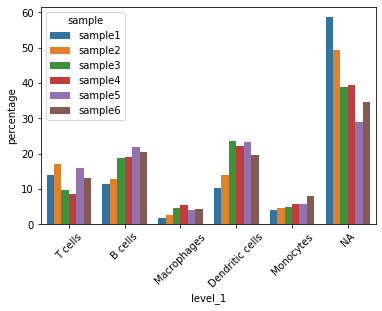

In [60]:
leiden_df = pd.DataFrame(sdata.obs.groupby('level_1')['sample'].value_counts().values)
leiden_df.columns = ['counts']
leiden_df['level_1'] = [i[0] for i in sdata.obs.groupby('level_1')['sample'].value_counts().index]
leiden_df['sample'] = [i[1] for i in sdata.obs.groupby('level_1')['sample'].value_counts().index]
leiden_df['sample'] = leiden_df['sample'].astype('category')
leiden_df['total_counts'] = leiden_df['sample'].values
leiden_df['total_counts'] = leiden_df['total_counts'].map(total_counts_dict)
leiden_df['counts'] = leiden_df['counts'].astype(np.float)
leiden_df['total_counts'] = leiden_df['total_counts'].astype(np.float)
leiden_df['percentage'] = leiden_df['counts'] / leiden_df['total_counts'] * 100

sns.barplot(x='level_1', y='percentage', hue='sample', data=leiden_df)
plt.xticks(rotation=45)
plt.savefig(os.path.join(output_path, f"cell_type_composition_sample.png"))
plt.show()

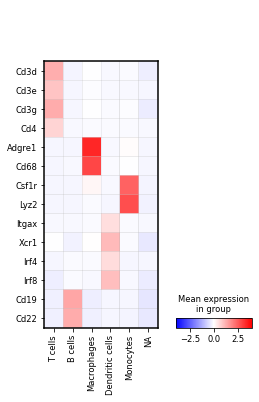

In [65]:
sc.pl.matrixplot(sdata, sdata.var.index, groupby=f'level_1', dendrogram=False, use_raw=False, cmap='bwr', vmin=-4, vmax=4, swap_axes=True)

sample1


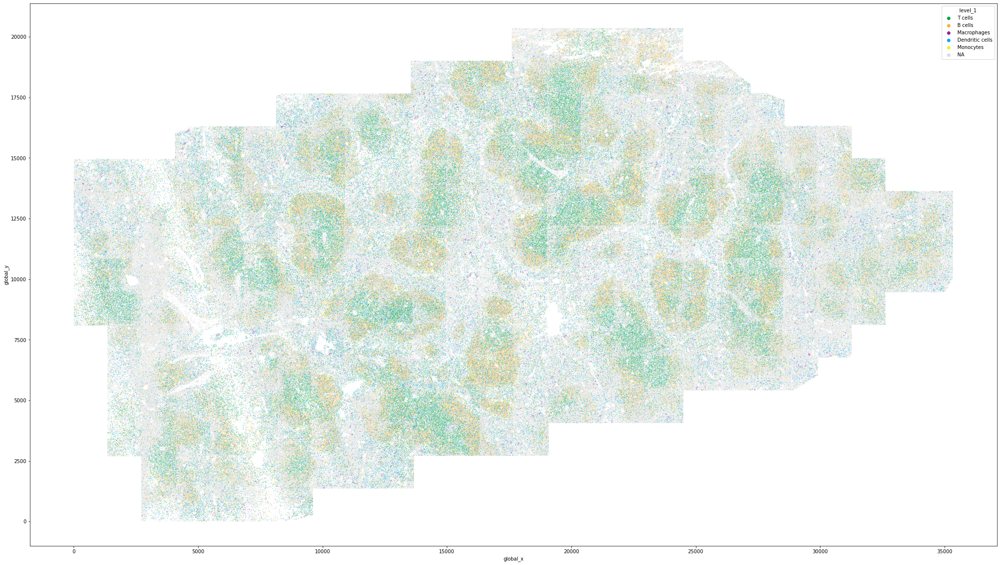

sample2


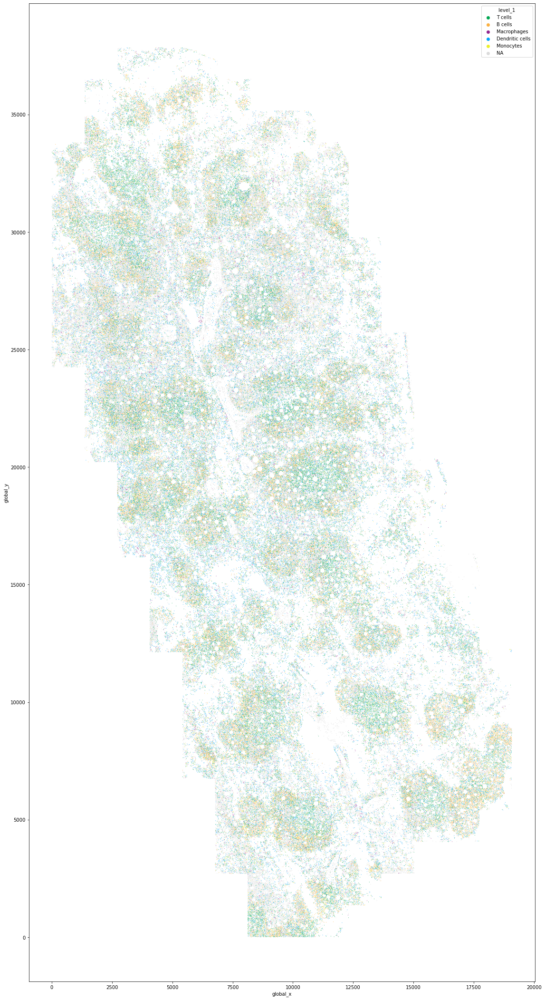

sample3


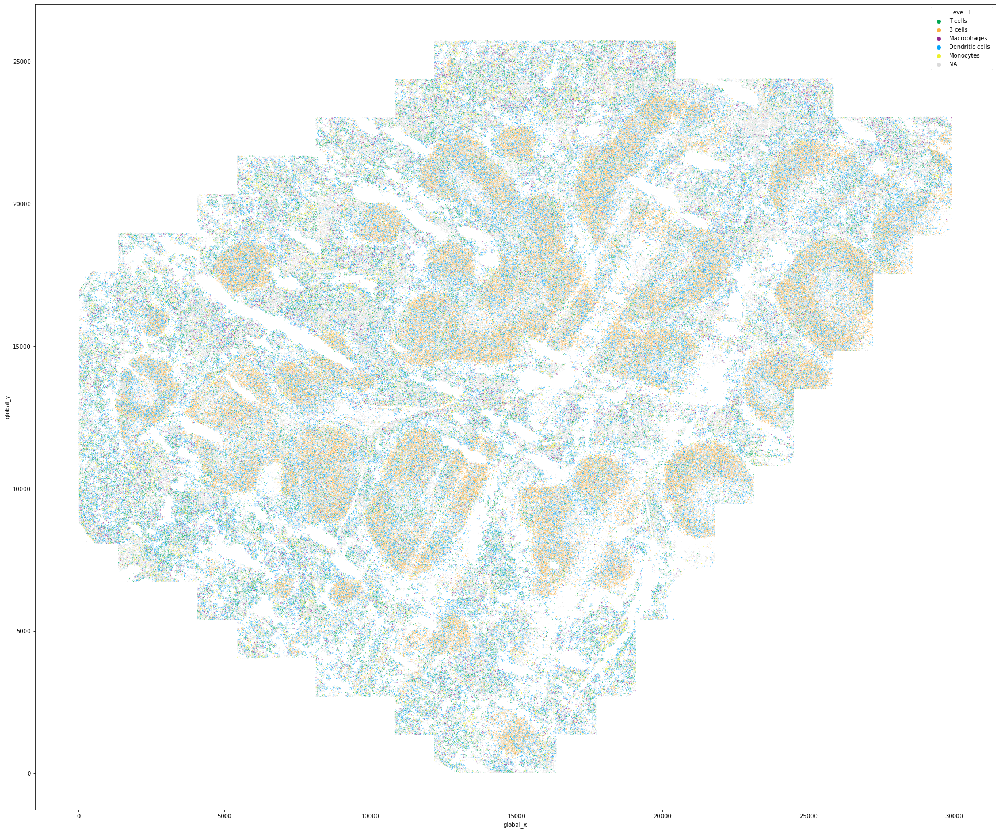

sample4


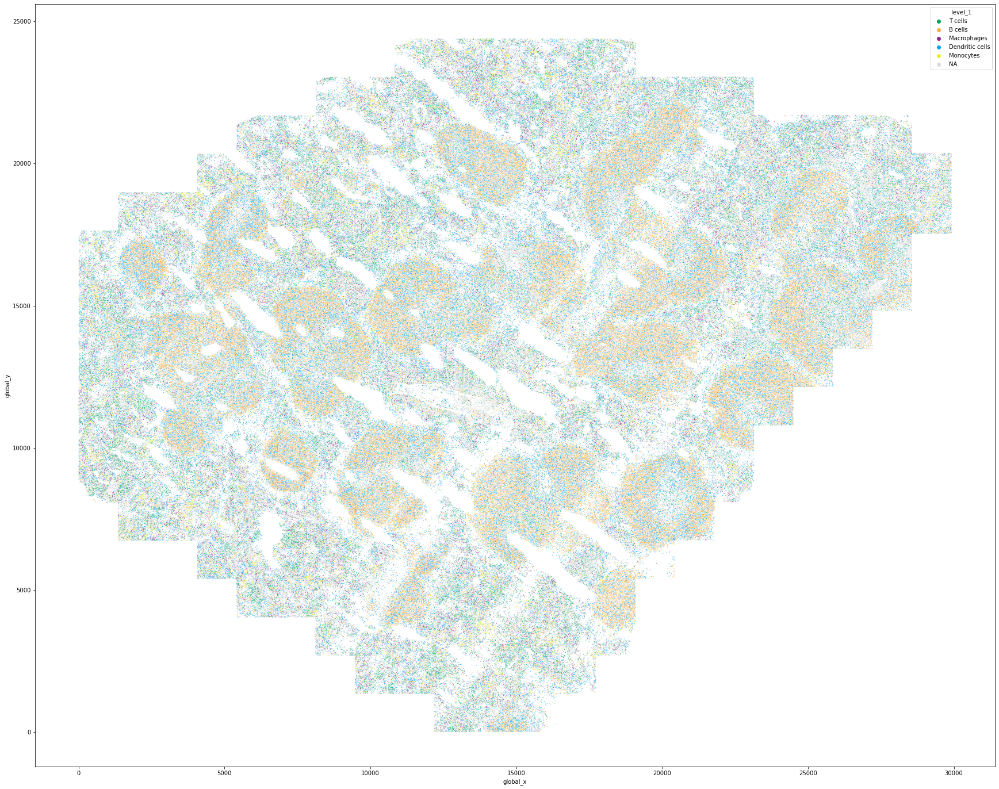

sample5


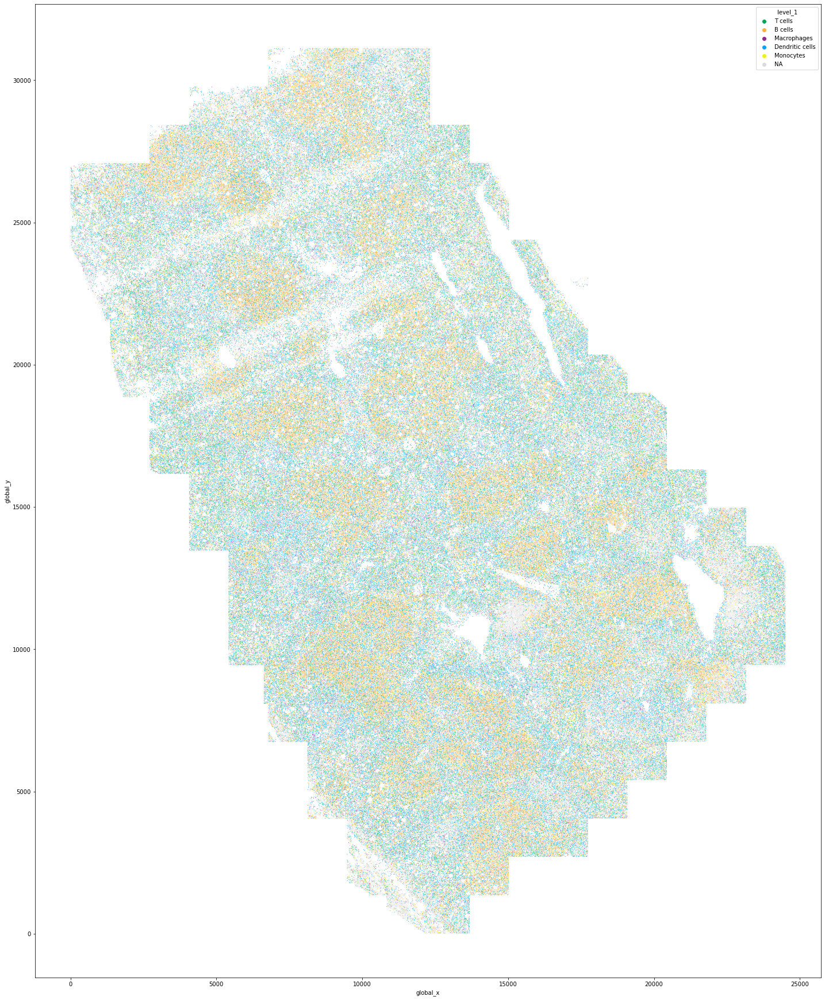

sample6


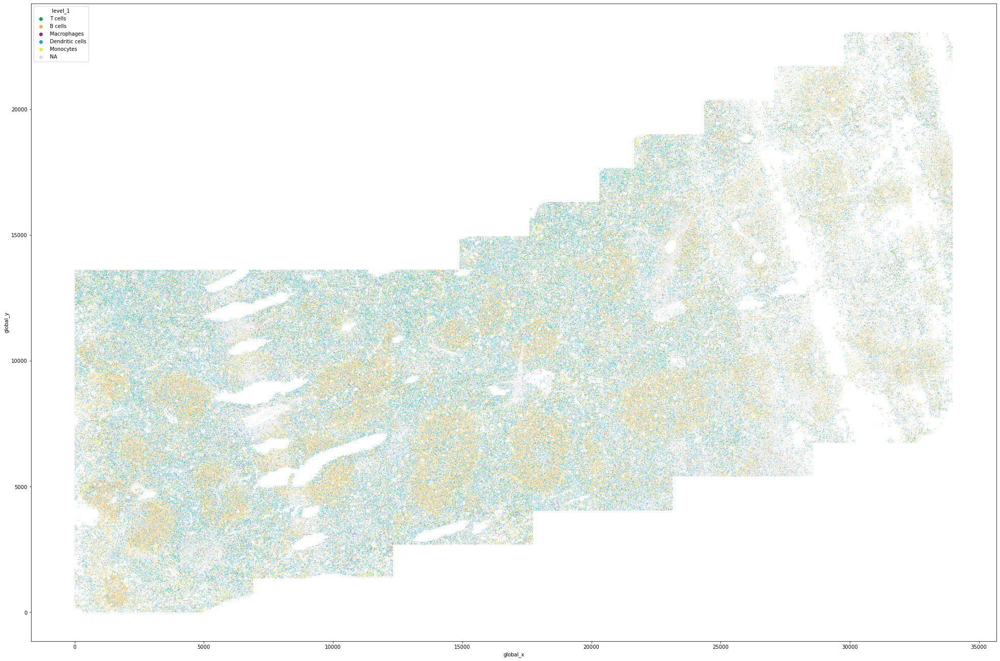

In [36]:
for current_sample in sdata.obs['sample'].unique():
    print(current_sample)
    current_obs = sdata.obs.loc[sdata.obs['sample'] == current_sample, :]
    
    fig_size = np.array([current_obs['global_x'].max(), current_obs['global_y'].max()]) / 1000
    fig, ax = plt.subplots(figsize=fig_size)
    sns.scatterplot(x='global_x', y='global_y', hue='level_1', data=current_obs, palette=level_1_pl, s=1, linewidth=0, ax=ax)
    plt.savefig(os.path.join(output_path, f"sct_{current_sample}.png"))
    plt.show()

sample1


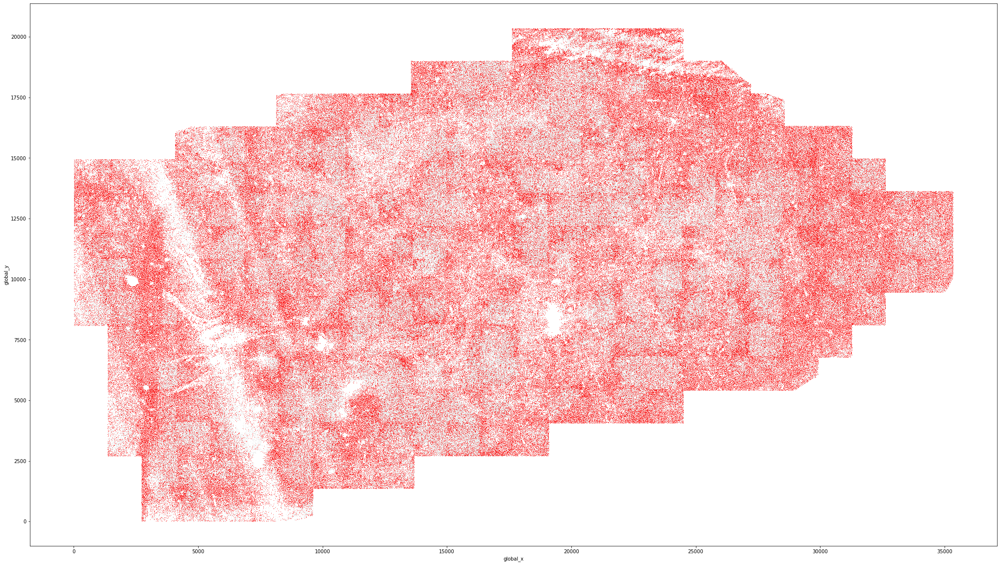

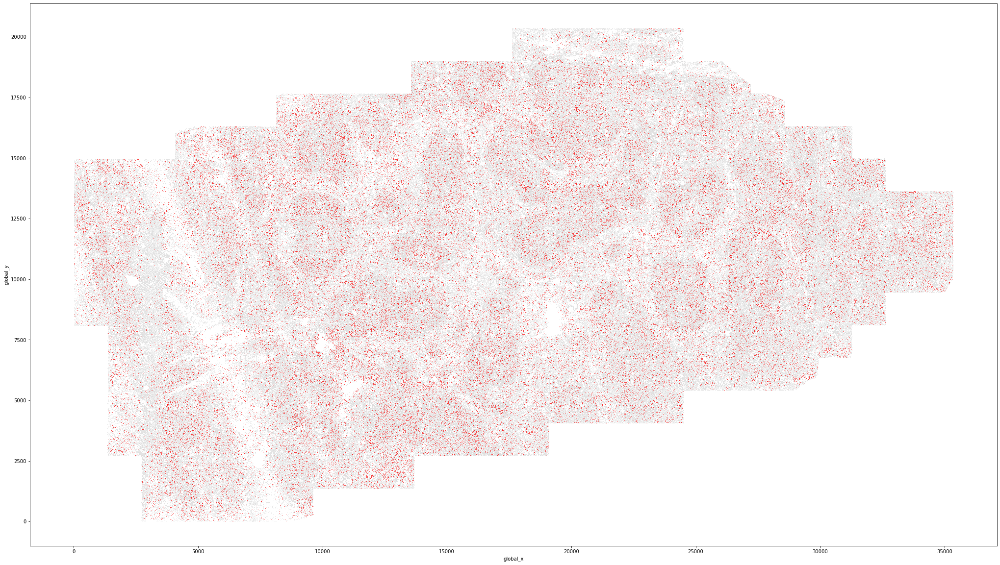

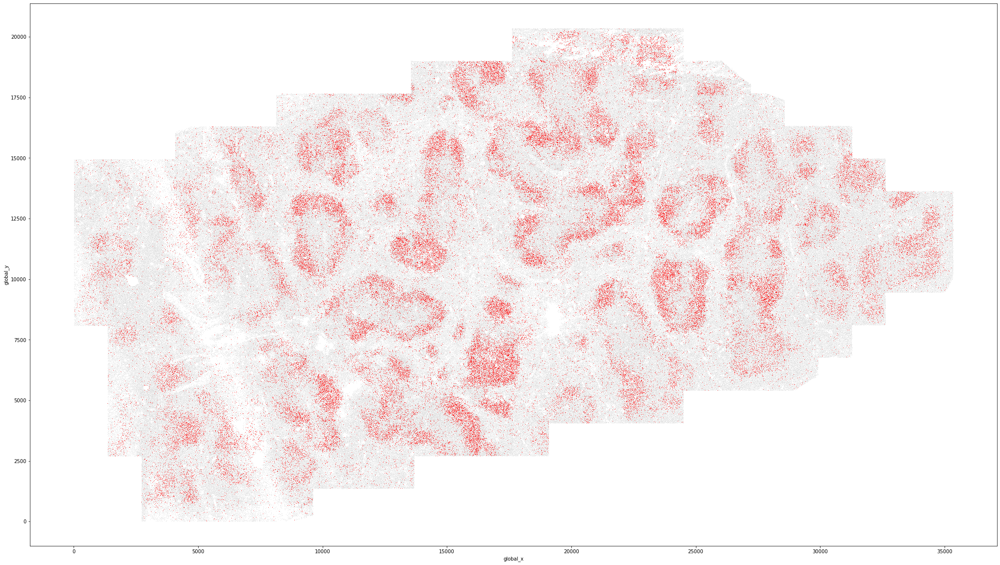

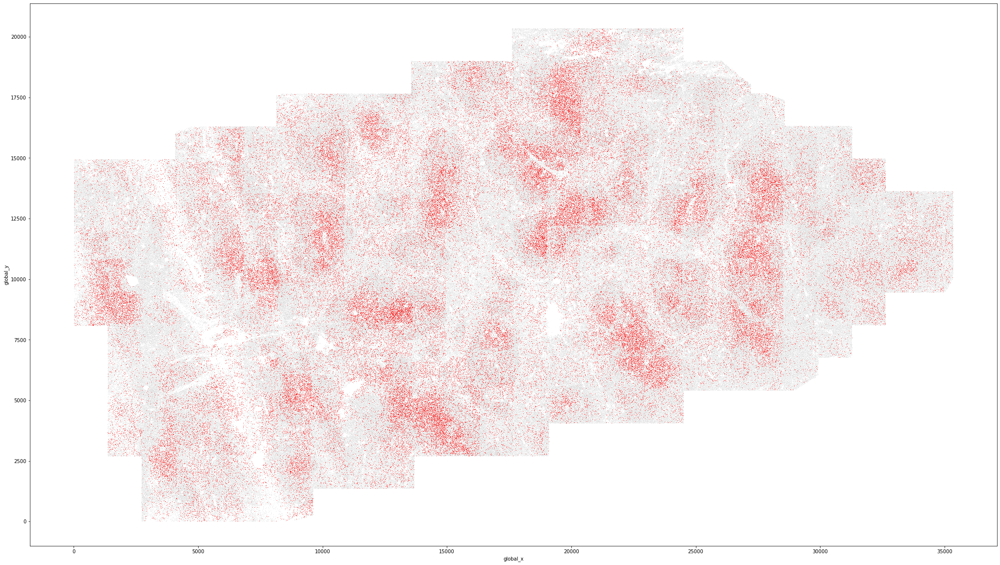

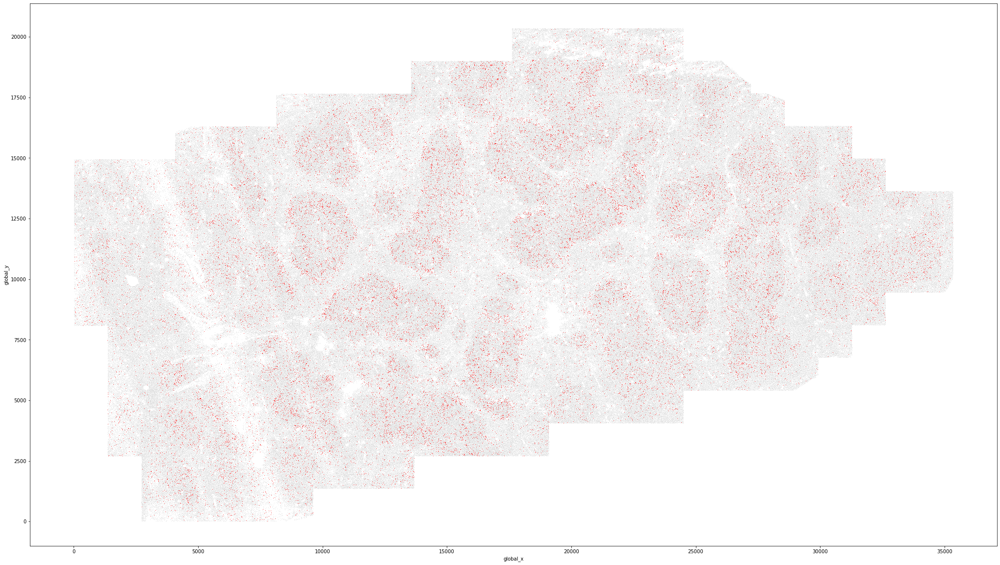

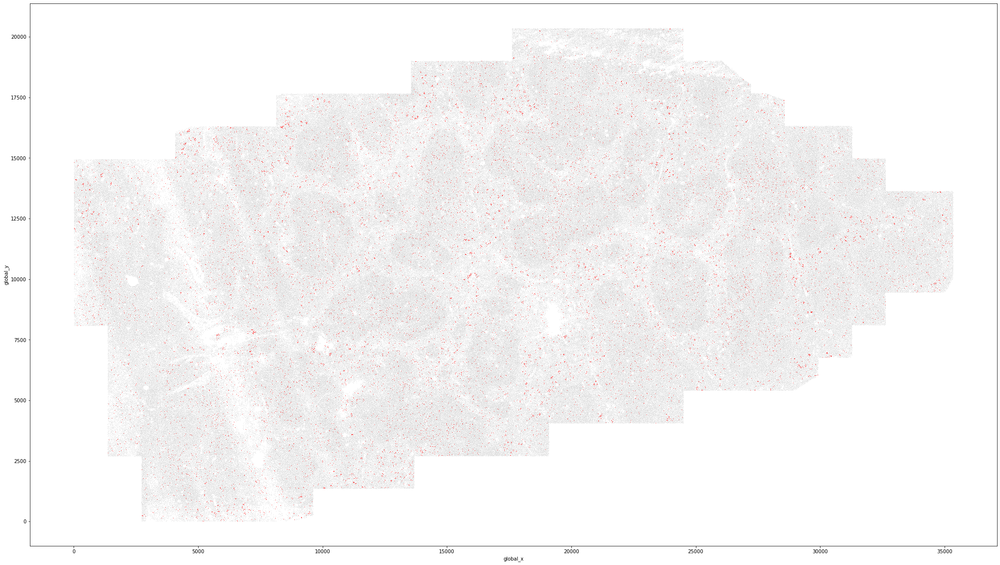

sample2


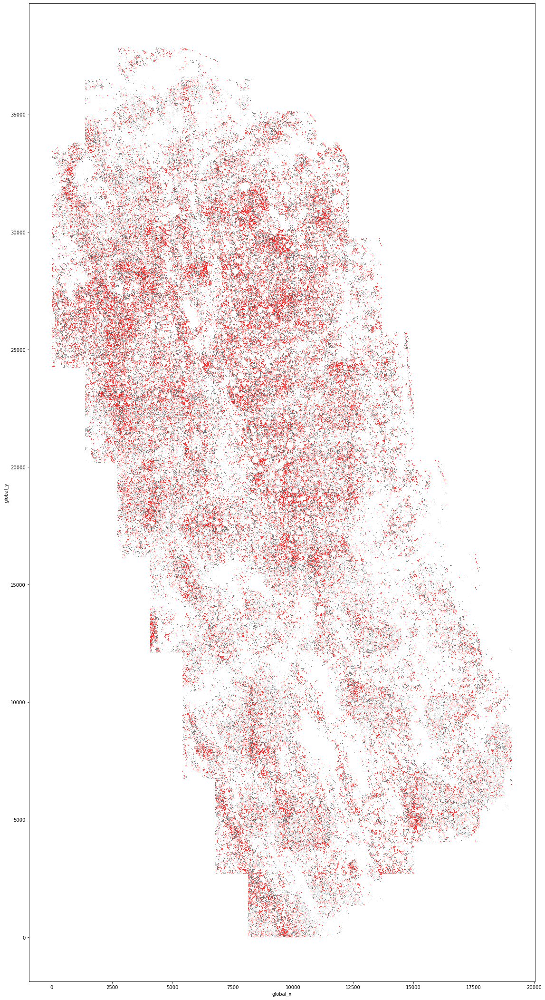

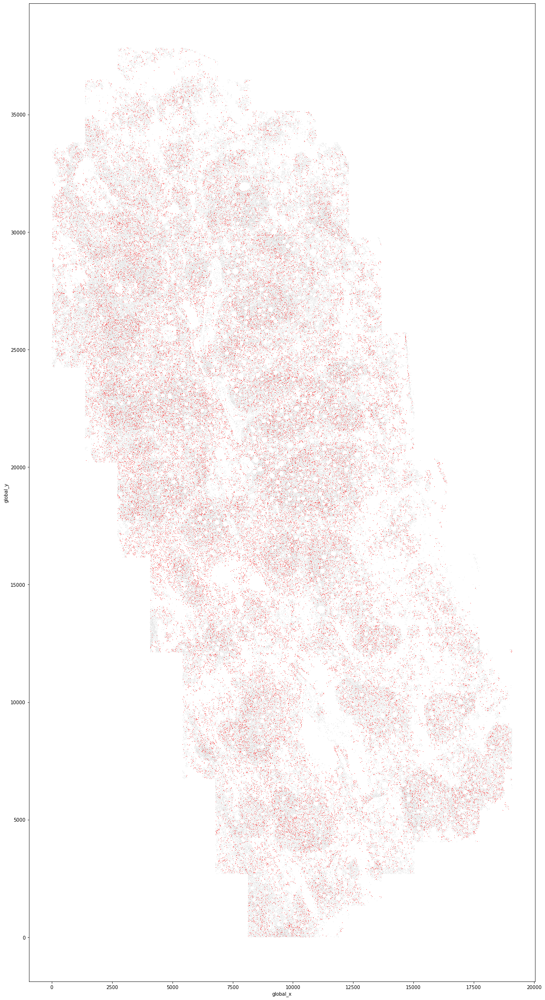

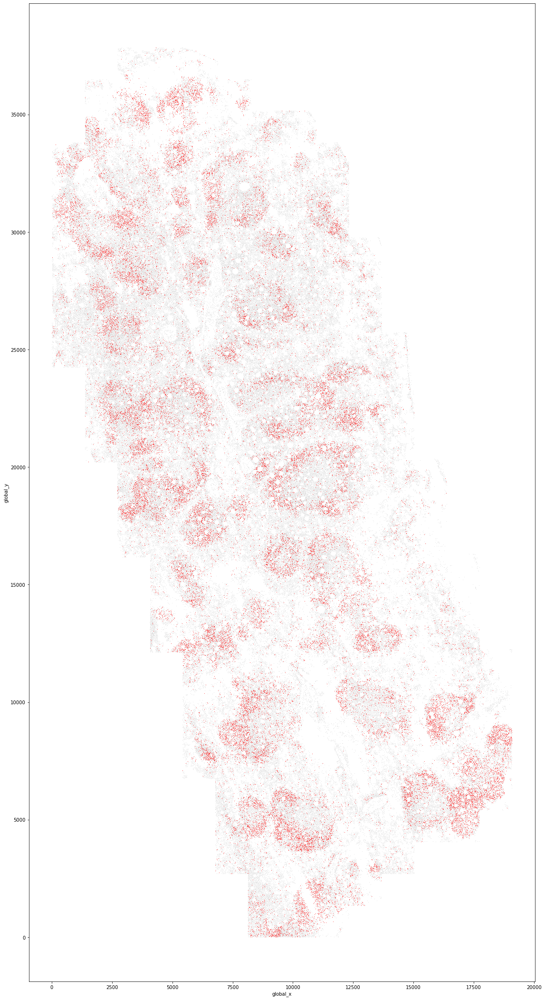

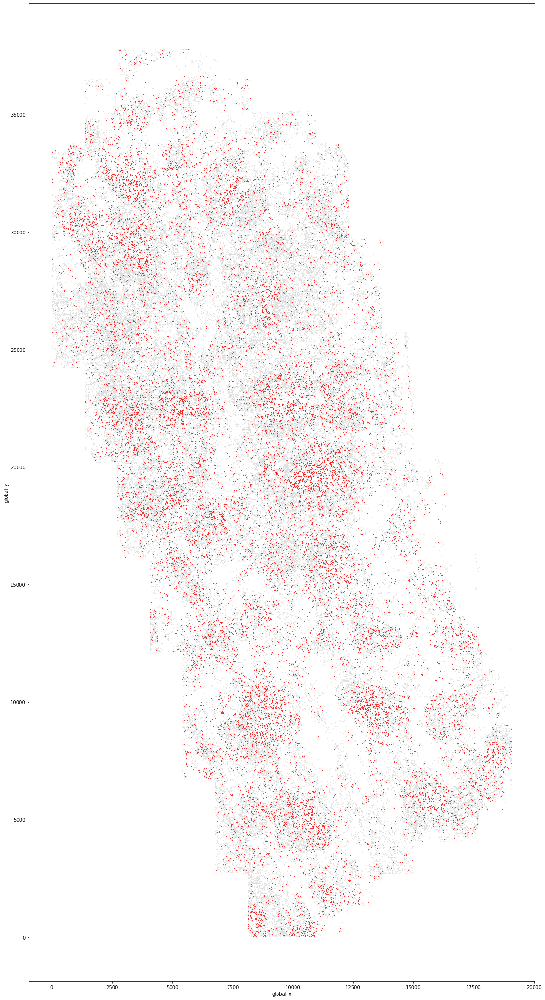

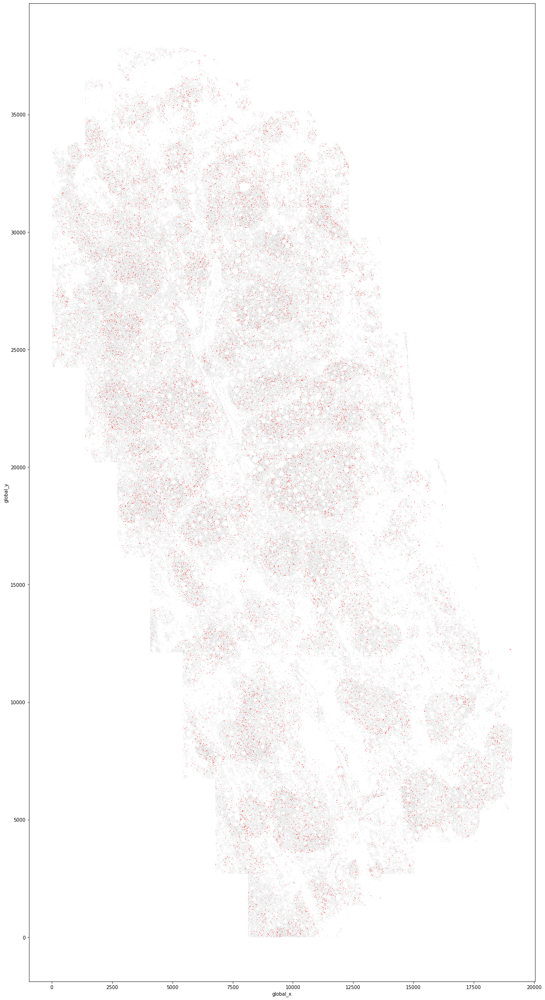

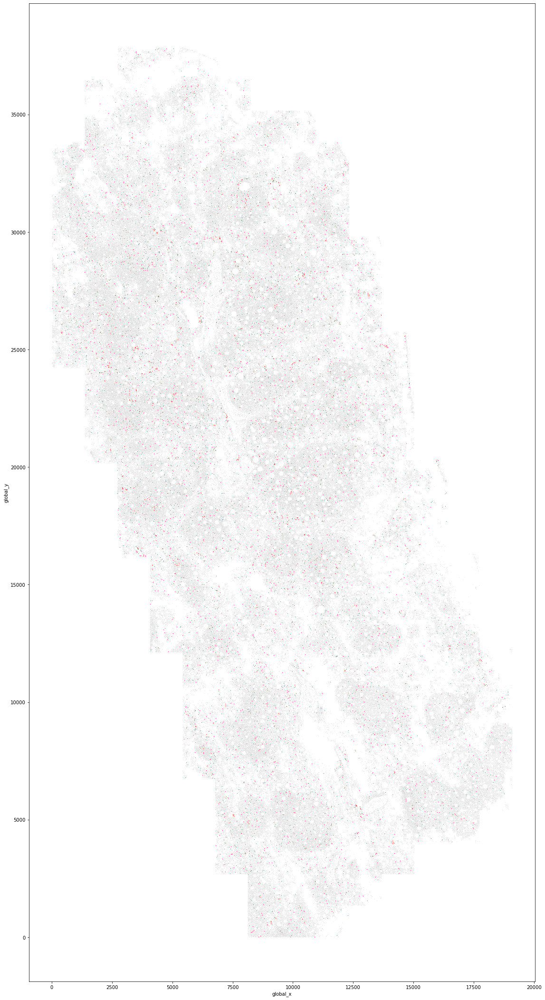

sample3


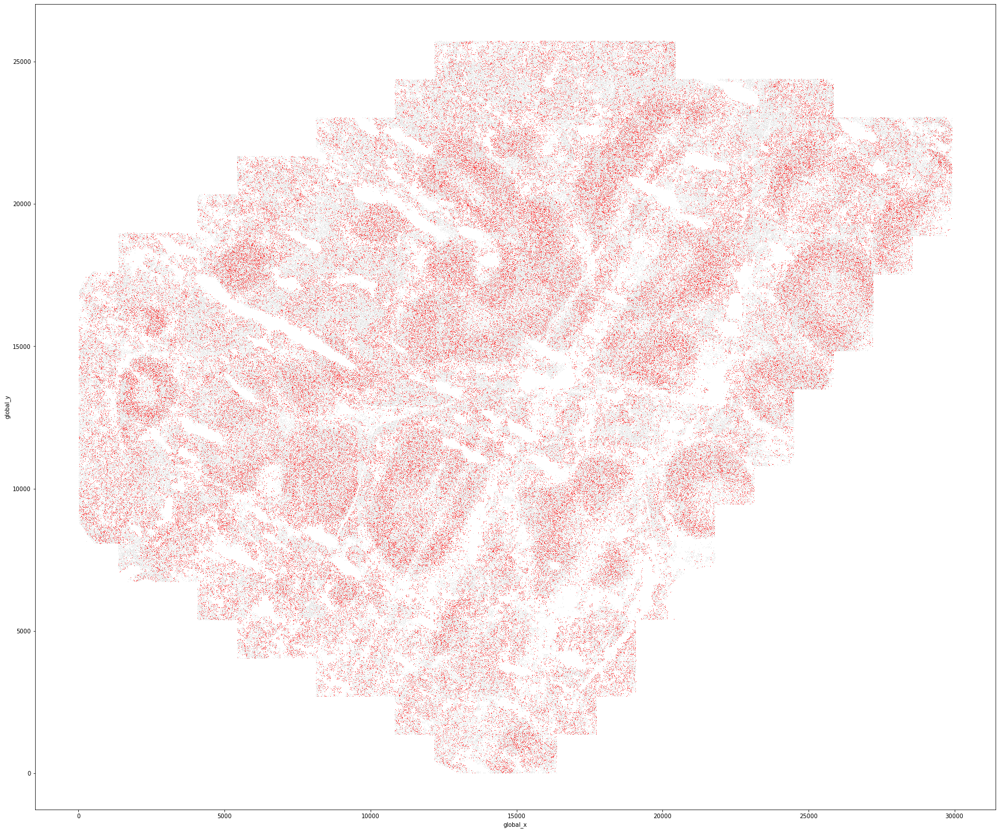

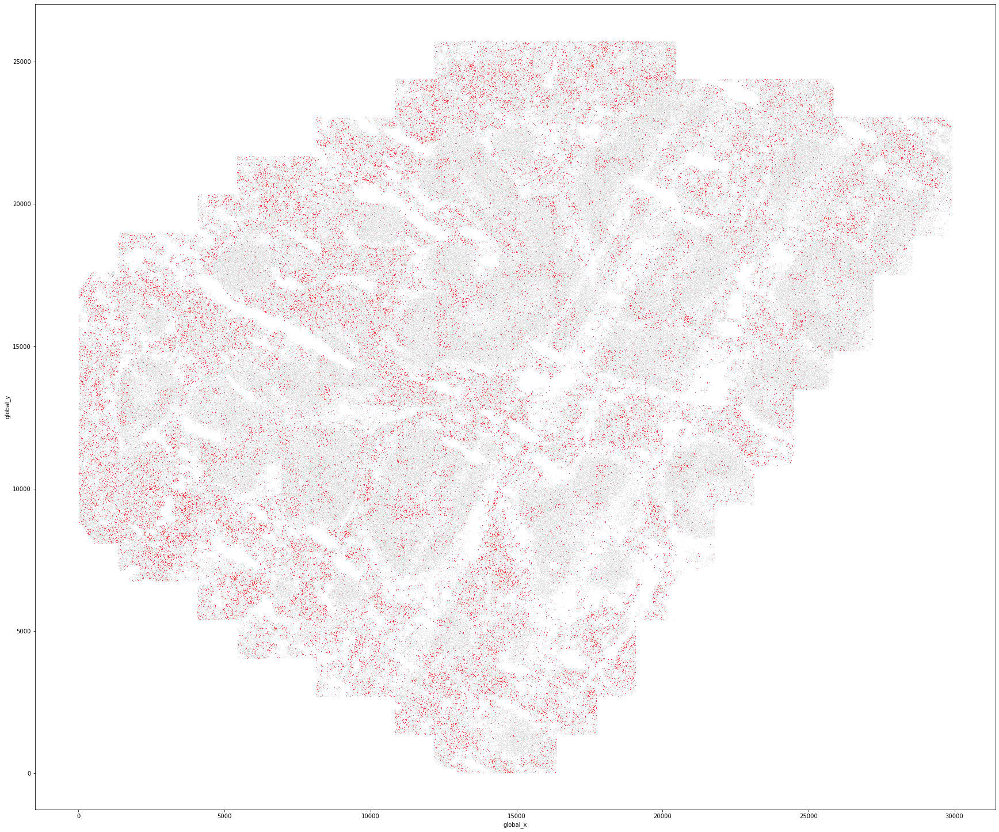

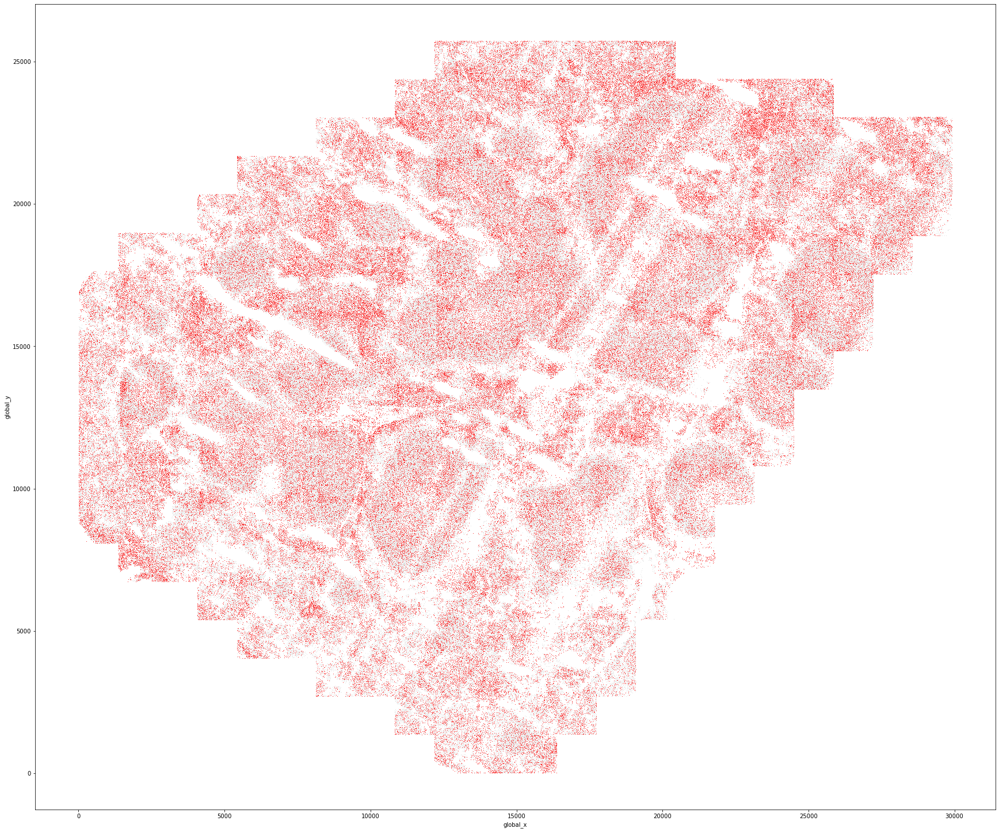

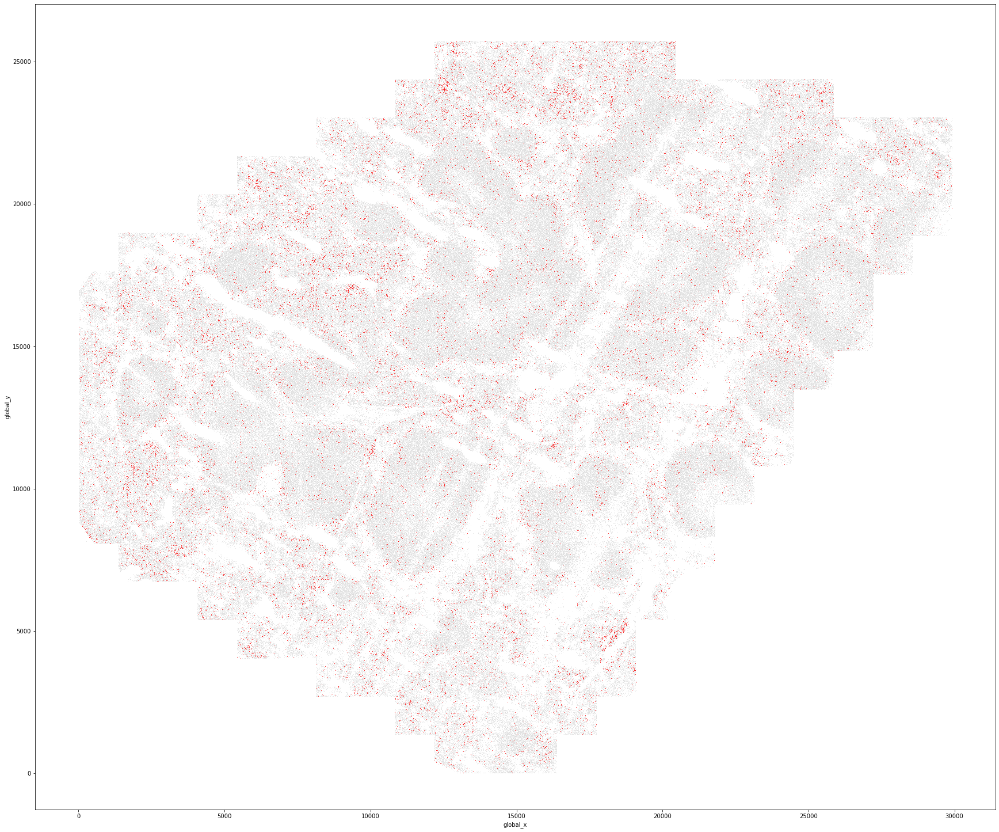

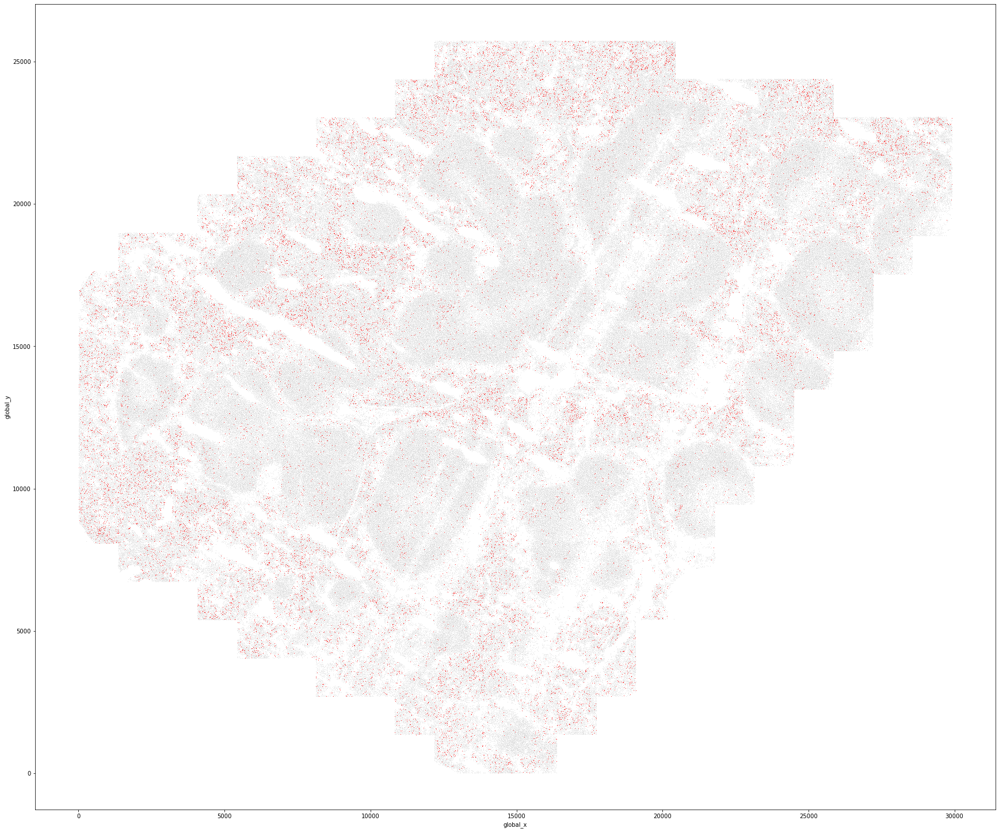

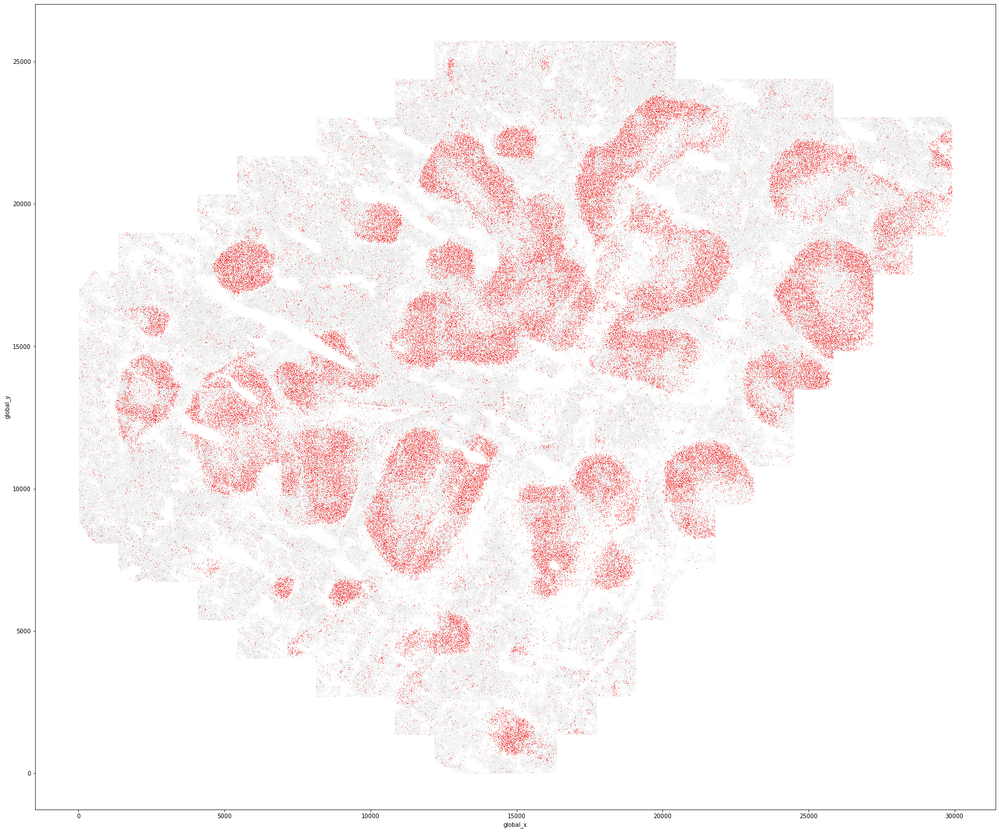

sample4


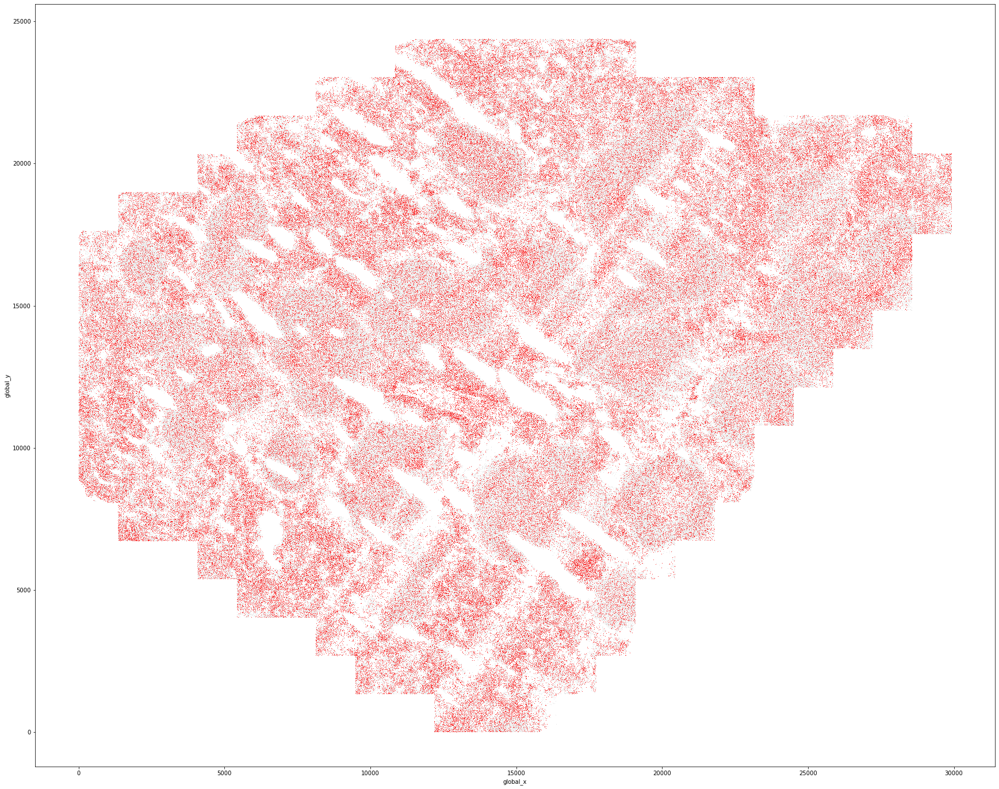

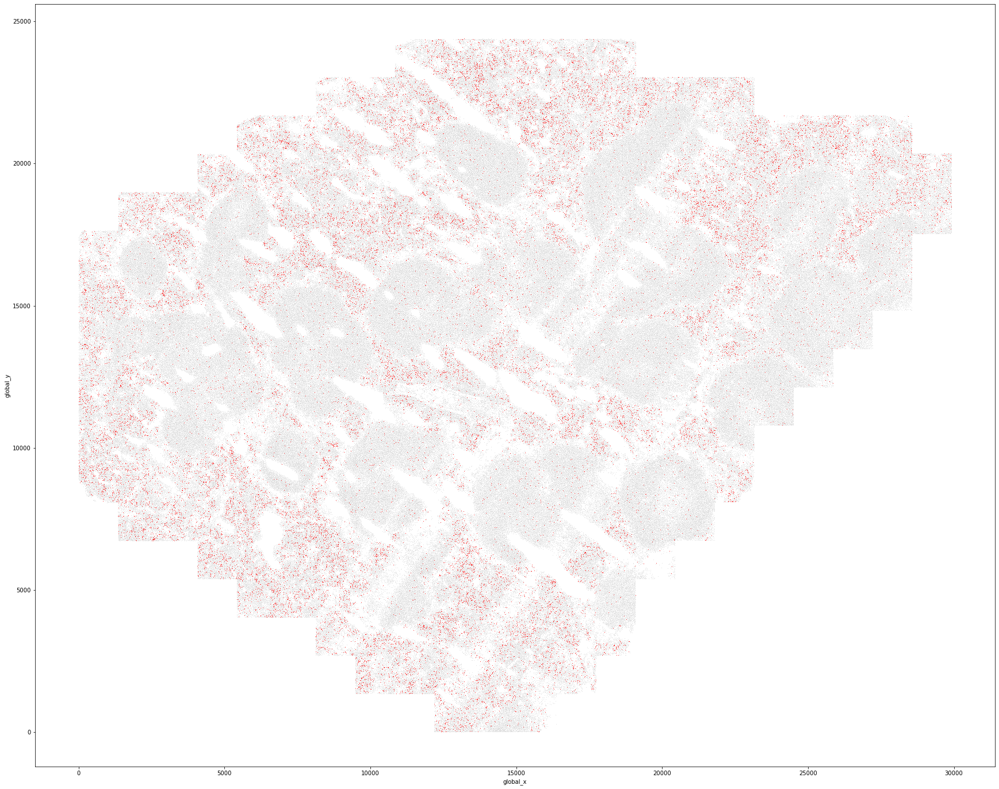

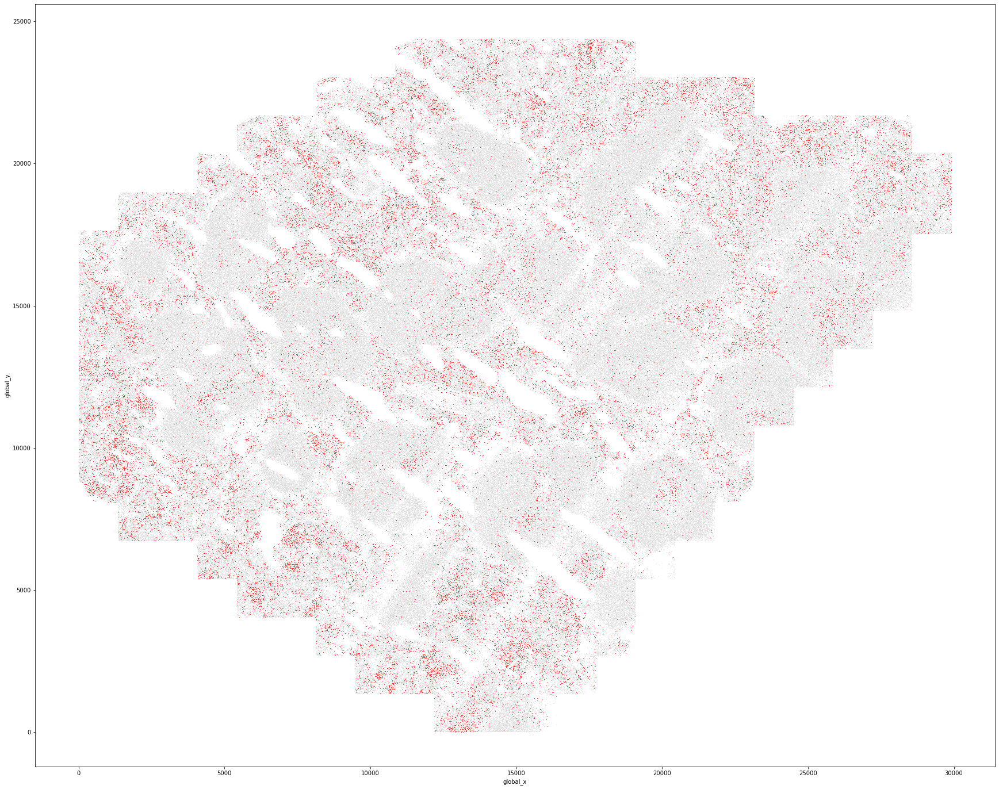

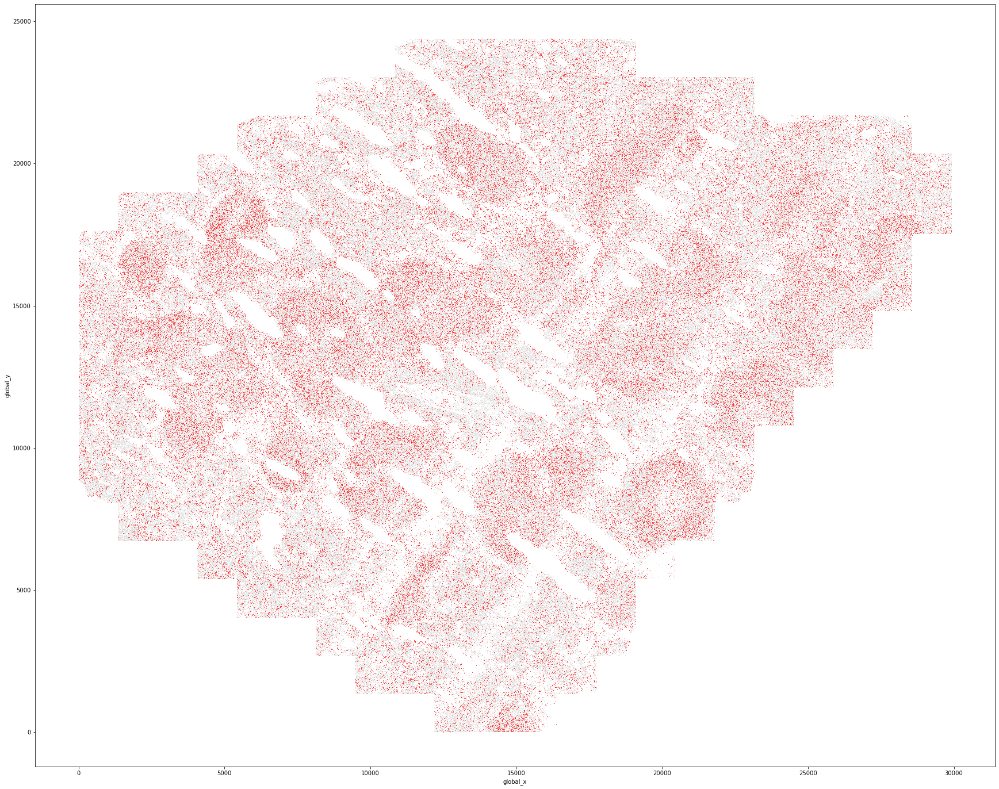

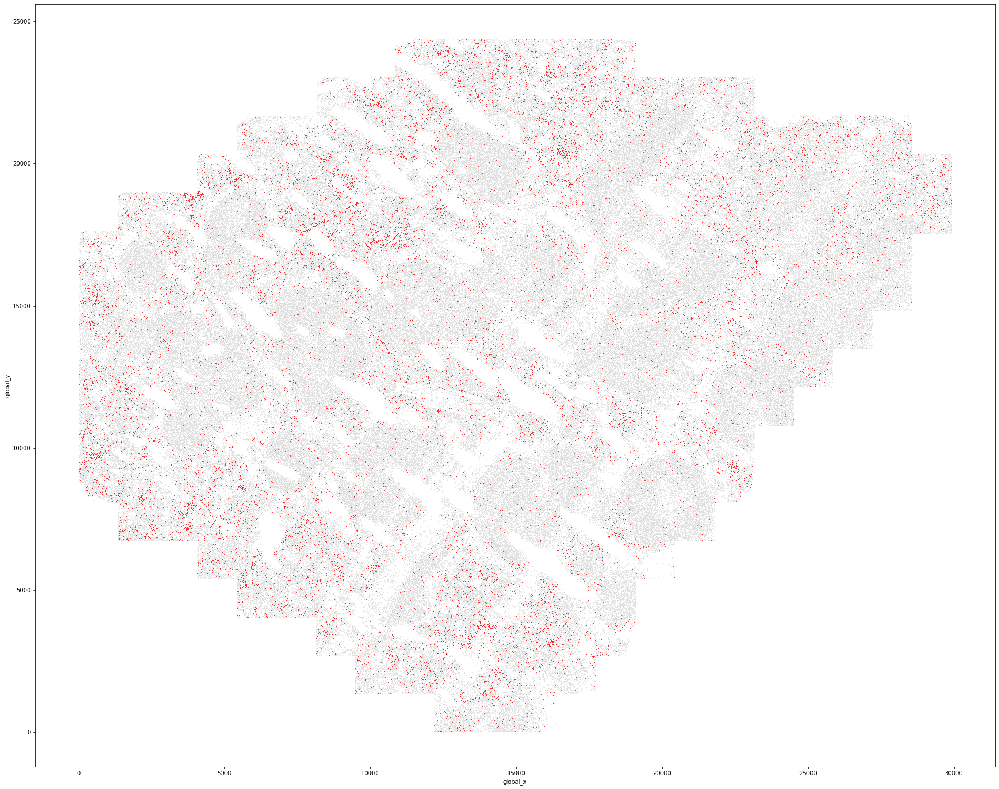

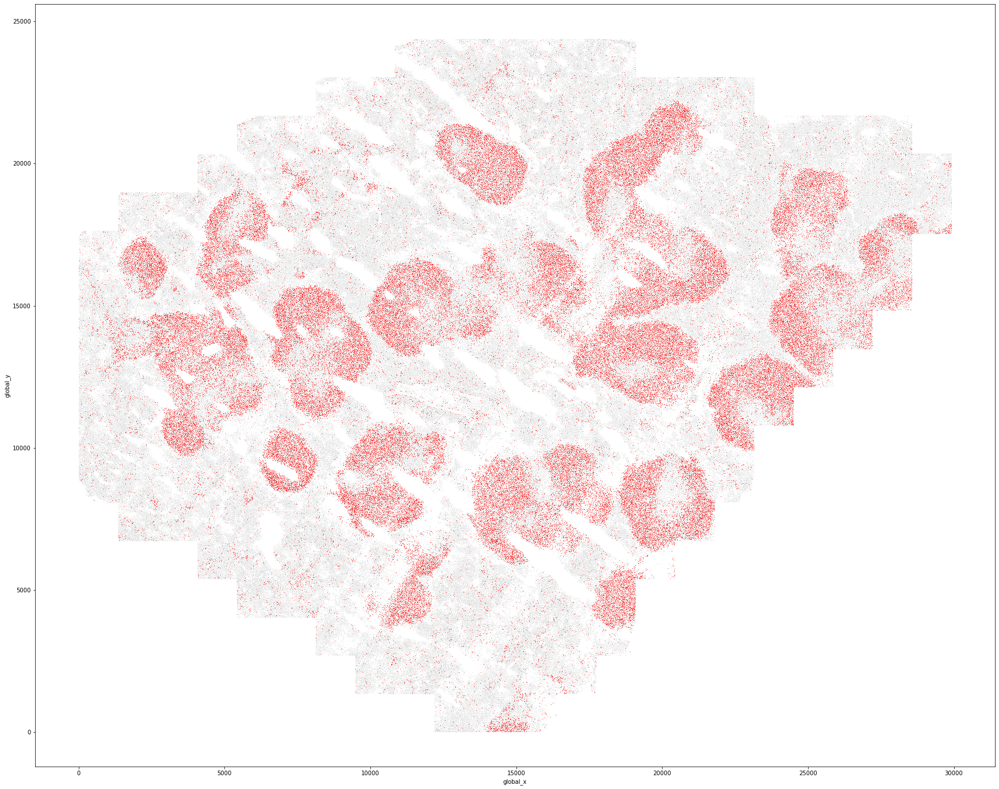

sample5


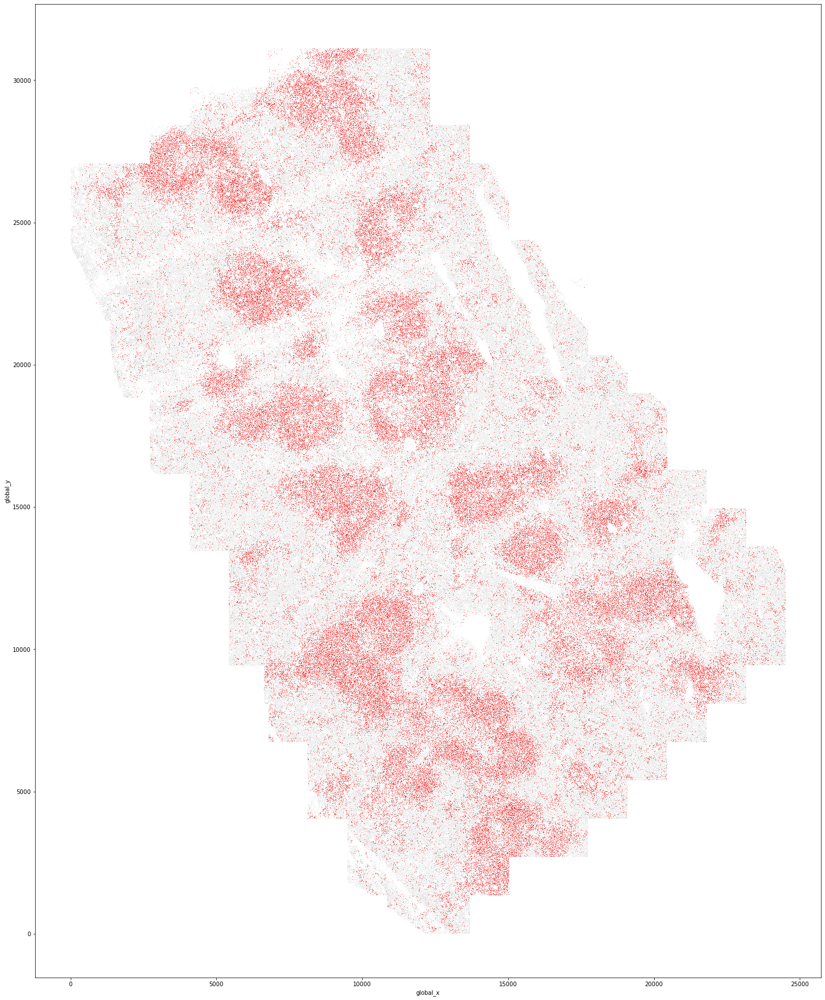

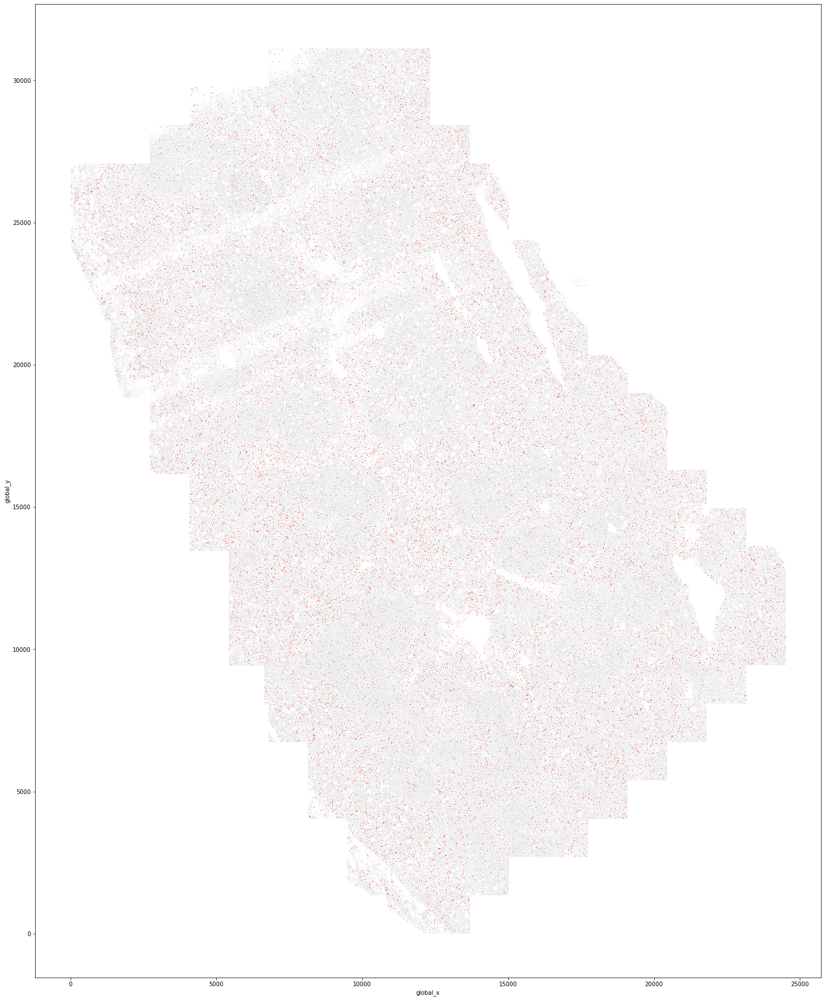

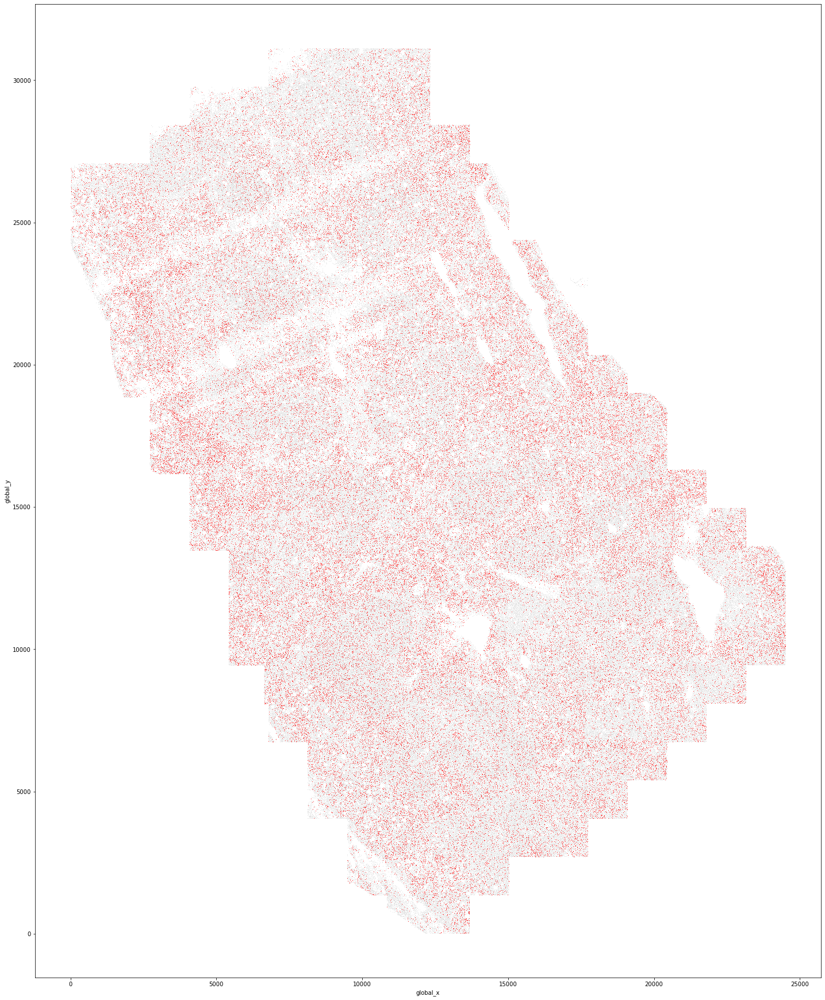

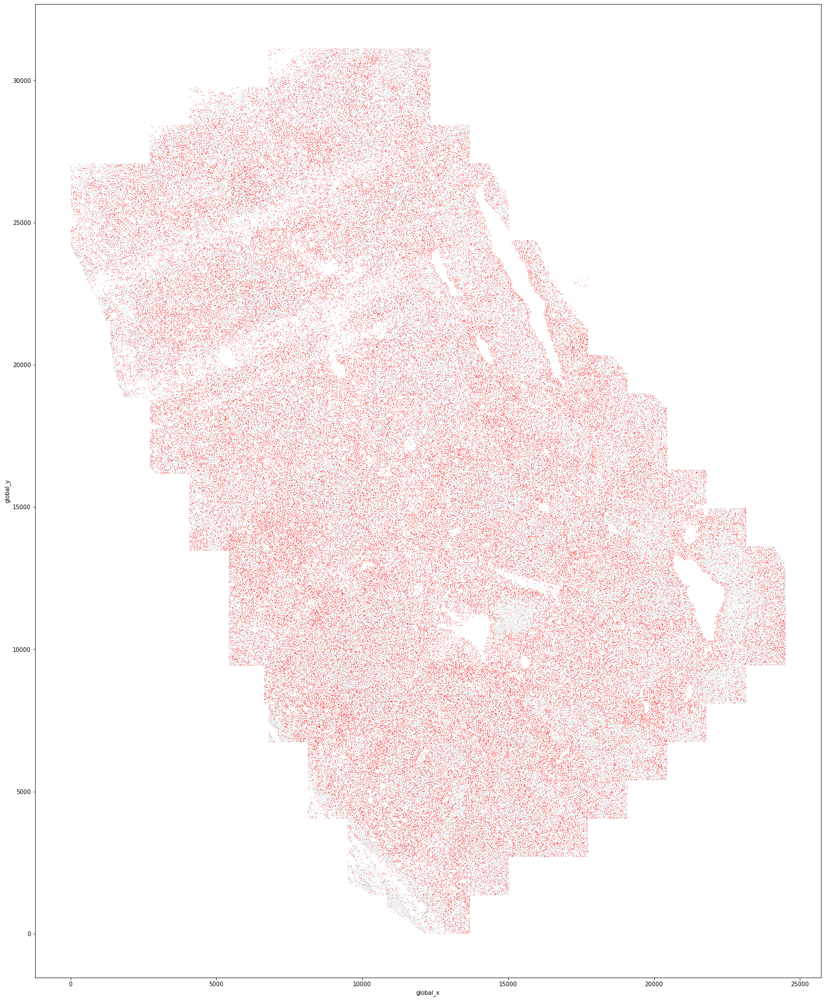

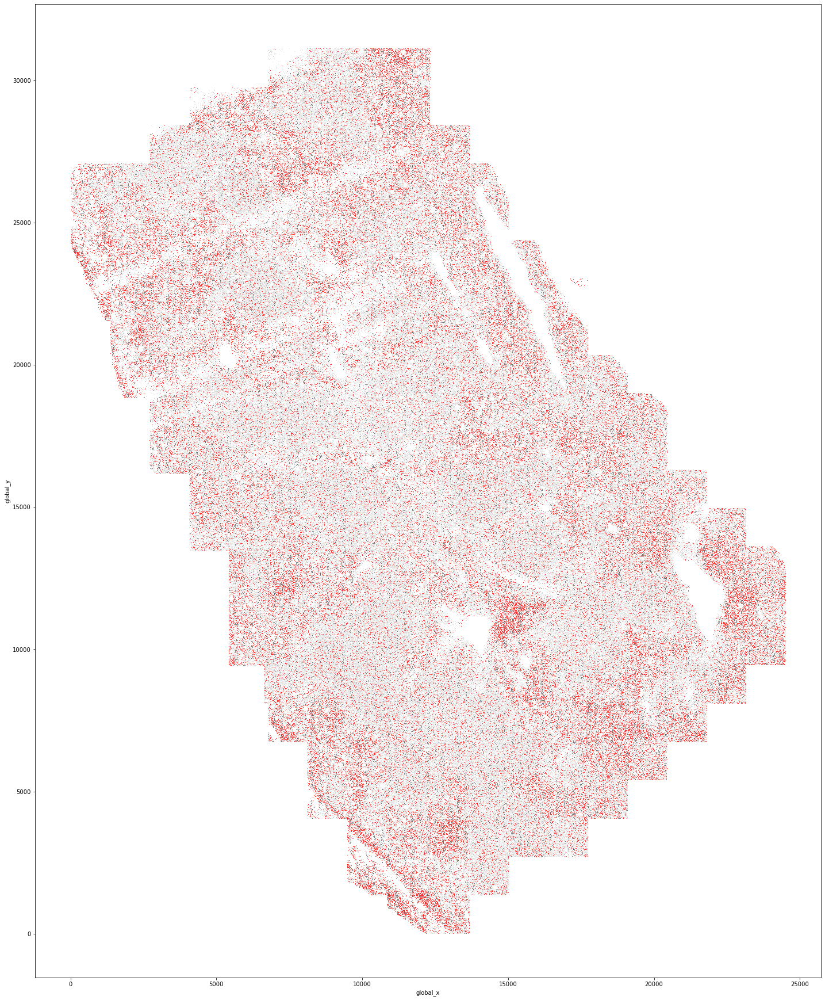

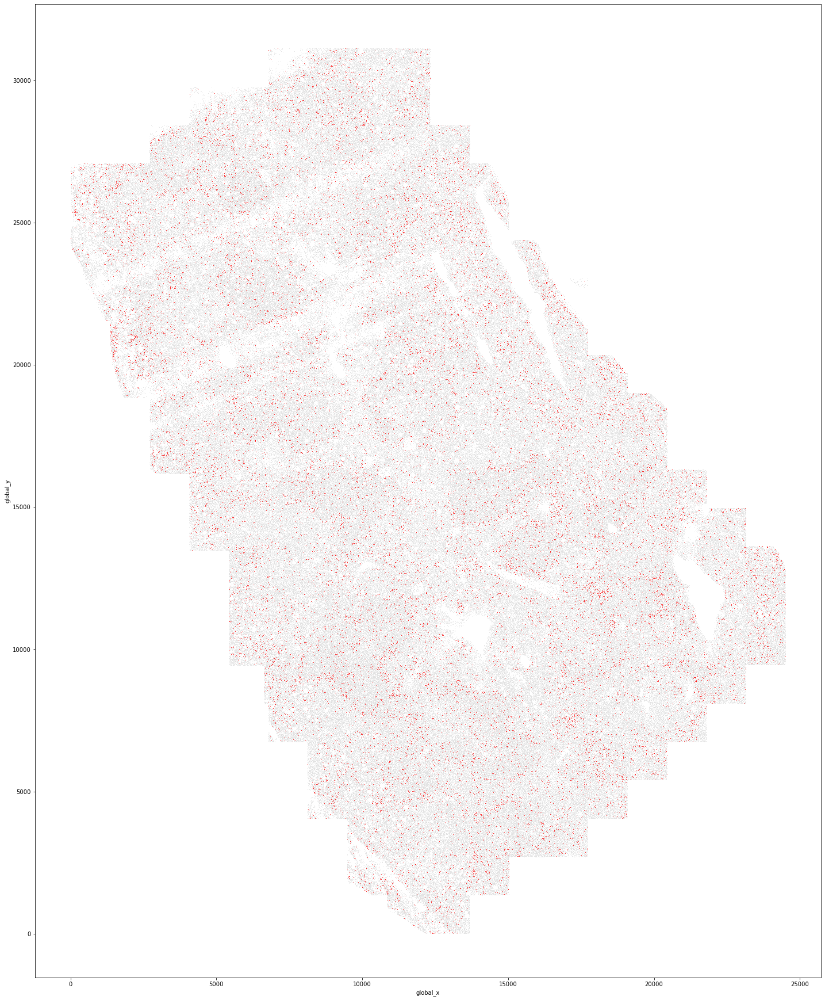

sample6


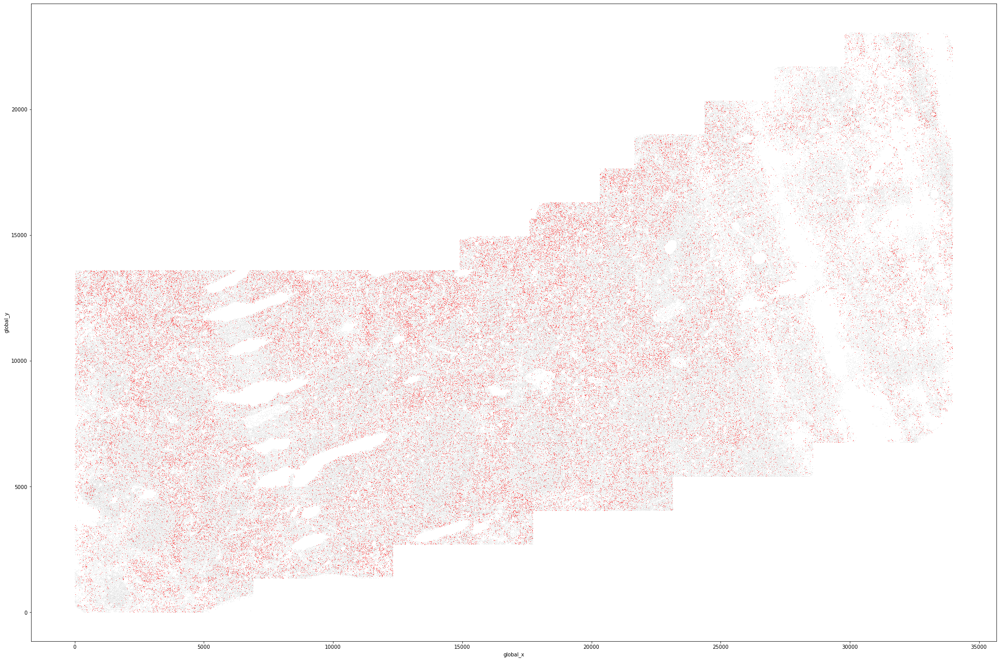

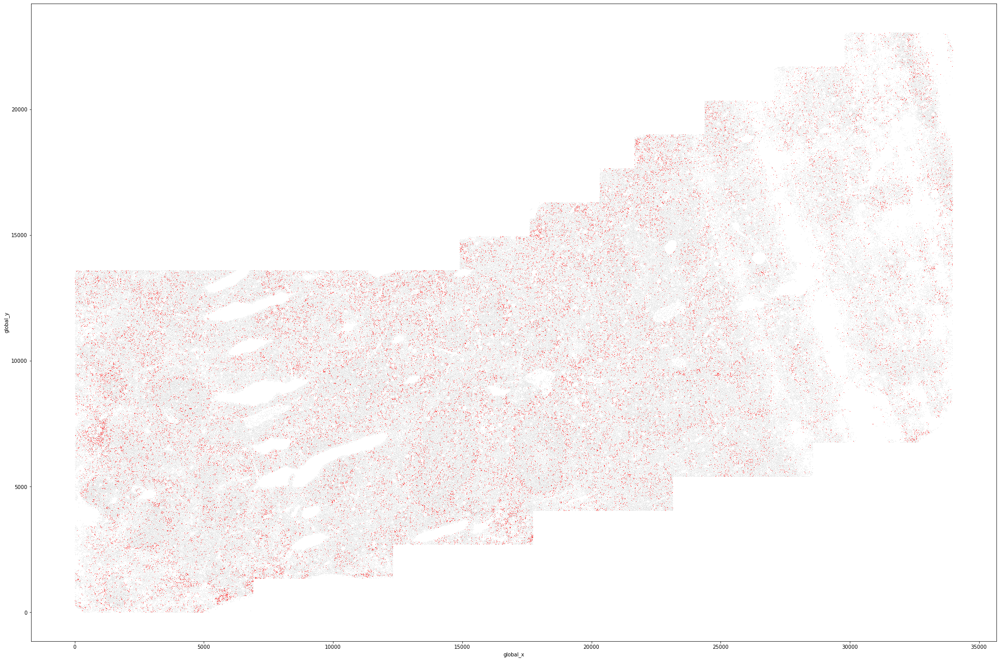

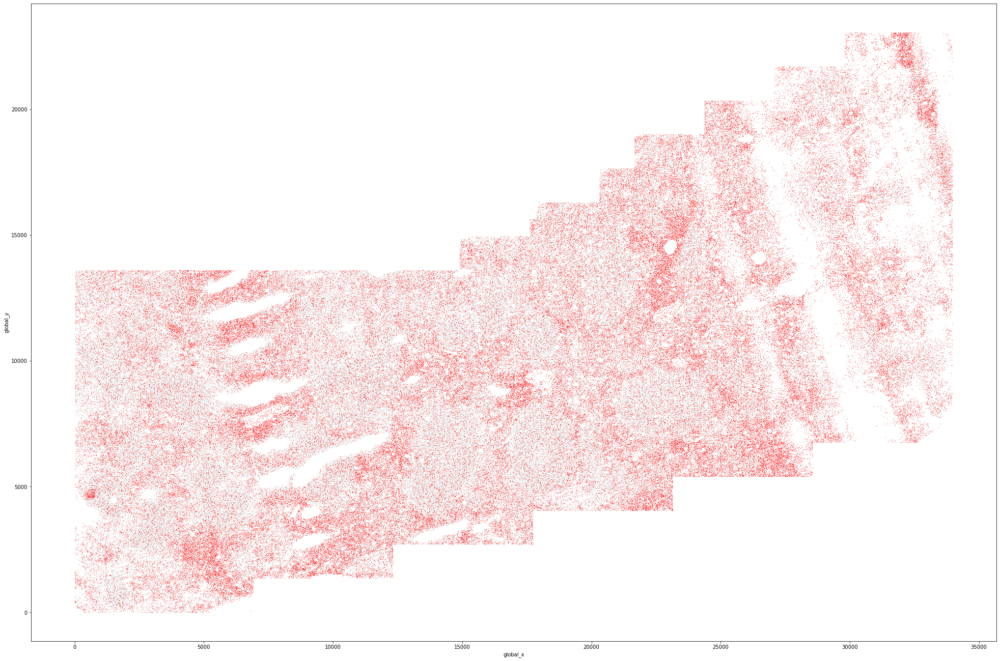

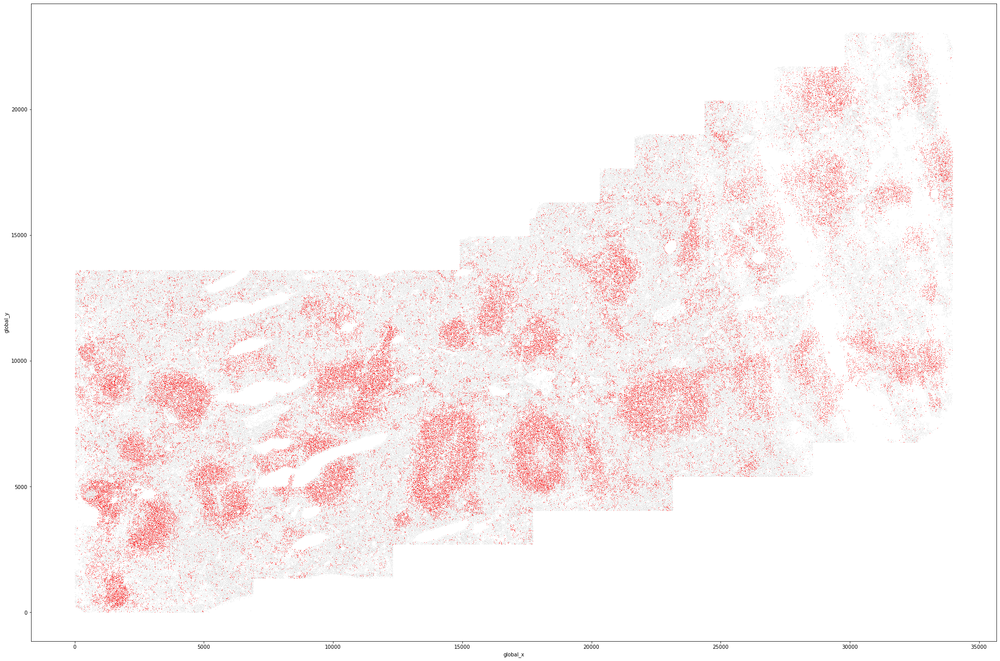

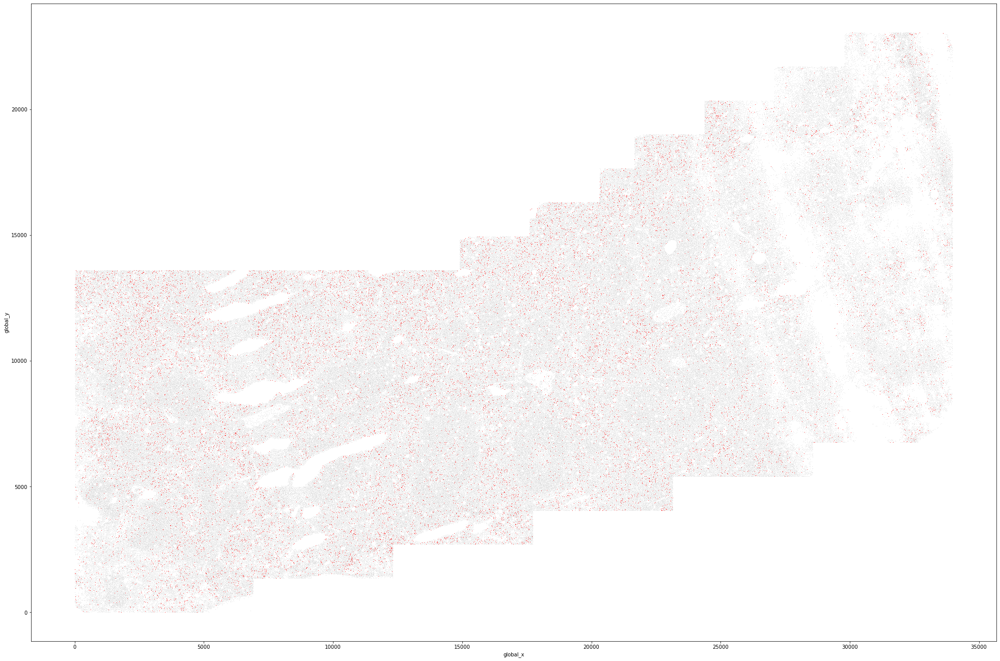

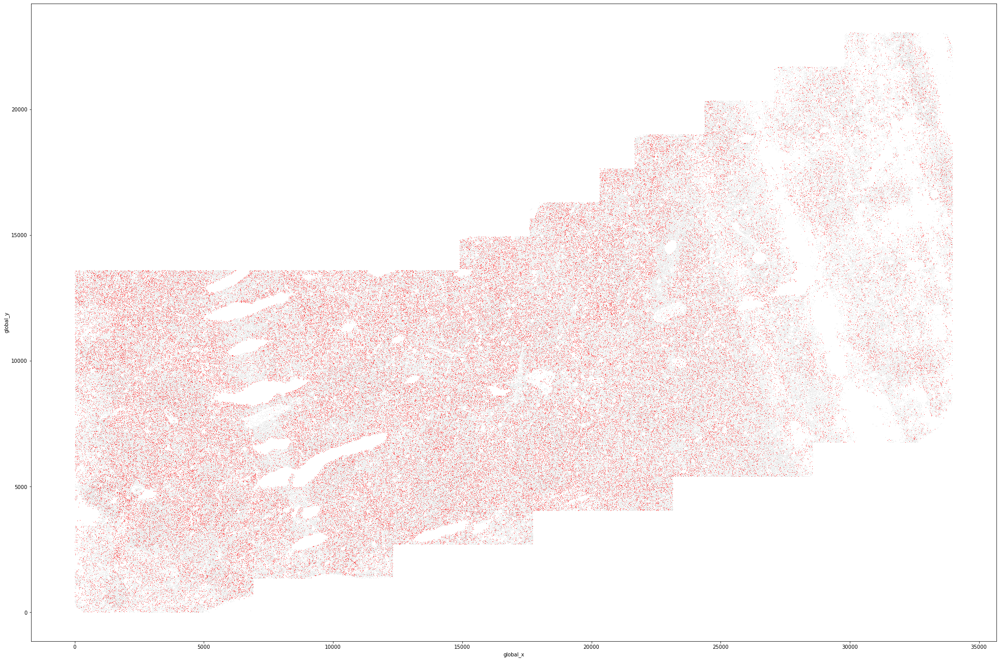

In [37]:
for current_sample in sdata.obs['sample'].unique():
    print(current_sample)
    current_obs = sdata.obs.loc[sdata.obs['sample'] == current_sample, :]
    
    for current_type in current_obs['level_1'].unique():
        current_type_obs =  current_obs.loc[current_obs['level_1'] == current_type, :]
        
        fig_size = np.array([current_obs['global_x'].max(), current_obs['global_y'].max()]) / 1000
        fig, ax = plt.subplots(figsize=fig_size)
        sns.scatterplot(x='global_x', y='global_y', color='#dbdbdb', data=current_obs, s=1, linewidth=0, ax=ax)
        sns.scatterplot(x='global_x', y='global_y', color='red', data=current_type_obs, s=1, linewidth=0, ax=ax)
        plt.savefig(os.path.join(output_path, f"sct_{current_sample}_{current_type}.png"))
        plt.show()

## T cells test

In [61]:
t_cell_genes = ['Cd3d', 'Cd3e', 'Cd3g', 'Cd8a', 'Cd4',
                'Foxp3', 'Il2ra', 'Il4', 'Ifng', 'Il17a',
               'Sell', 'Lef1', 'Ccr7',]

In [62]:
tdata = cdata[sdata.obs['level_1'] == 'T cells', t_cell_genes]
tdata

View of AnnData object with n_obs × n_vars = 405293 × 13
    obs: 'sample', 'fov_id', 'volume', 'fov_x', 'fov_y', 'fov_z', 'seg_label', 'global_x', 'global_y', 'global_z'
    var: 'mean', 'std'
    uns: 'log1p'
    layers: 'scaled'

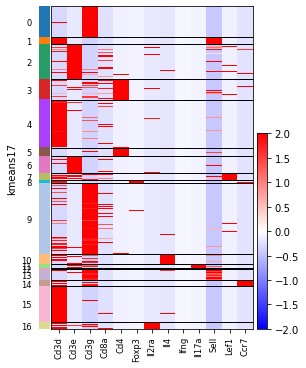

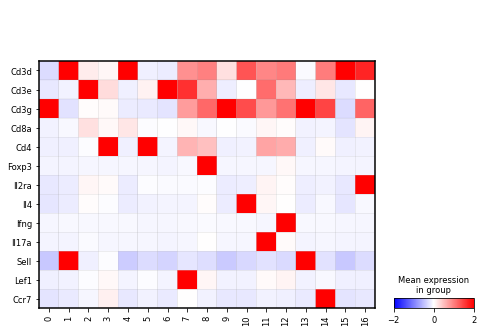

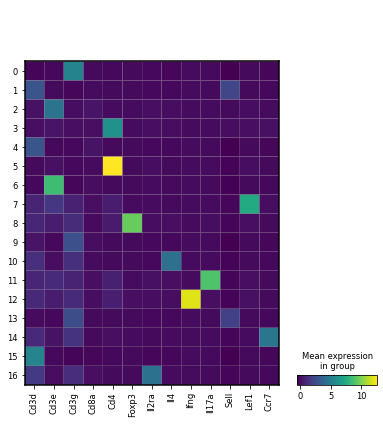

In [64]:
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score

# Use PCA embedding
# extract pca coordinates
# X_pca = sdata.obsm['X_pca']
X_pca = tdata.X

# kmeans with k=8
k = 17
kmeans = KMeans(n_clusters=k, random_state=5).fit(X_pca)
tdata.obs[f'kmeans{k}'] = kmeans.labels_.astype(str)

# sc.pl.pca(sdata, color=[f'kmeans{k}'])
sc.pl.heatmap(tdata, tdata.var.index, groupby=f'kmeans{k}', dendrogram=False, use_raw=False, cmap='bwr', vmin=-2, vmax=2)
sc.pl.matrixplot(tdata, tdata.var.index, groupby=f'kmeans{k}', dendrogram=False, use_raw=False, cmap='bwr', vmin=-2, vmax=2, swap_axes=True)
sc.pl.matrixplot(tdata, tdata.var.index, groupby=f'kmeans{k}', dendrogram=False, use_raw=False)